<a href="https://colab.research.google.com/github/IsabelJnz/NLP-Project/blob/main/Presentation_NLP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1/> What is the future of Chat GPT in society? <h1>

<p> NLP Project - Ibele Luisa, Janez Isabel </p>



## EDA


### Imports, Installations and Loading data

In [3]:
%pip install plotly_express

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
%pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.3/6.3 MB 28.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 75.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.2/199.2 KB 19.4 MB/s eta 0:00:00


In [5]:
%pip install nrclex

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 396.4/396.4 KB 8.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for nrclex: filename=NRCLex-3.0.0-py3-none-any.whl size=43329 sha256=36f9a44770c5ec95f26731c269015572f7dcd77a51f32b6cd174d7612dce3f73
  Stored in directory: /root/.cache/pip/wheels/68/c4/f2/c390dd3eac398fdf45f7a01c6516bc53fa7a9ab59c7d2ff518
Successfully built nrclex


In [4]:
# imports
import csv
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly_express as px
import numpy as np
import nltk 

In [9]:
from google.colab import drive

# mount the 'My Drive' folder
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
with open('/content/drive/MyDrive/NLP/tweets.csv', 'r', encoding='utf-8') as file:
    reader = csv.reader(file)
    header = next(reader)
    data = [row for row in reader]

df = pd.DataFrame(data, columns=header)

In [ ]:
with open('tweets.csv', 'r', encoding='utf-8') as file:
    reader = csv.reader(file)
    header = next(reader)
    data = [row for row in reader]

df = pd.DataFrame(data, columns=header)

FileNotFoundError: ignored

### Basic Information

In [ ]:
df.head()

,user_name,text,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,hashtags,source
0,ADtweets,#ChatGPT is really changing and shaking up the...,,,2020-01-26 21:05:14+00:00,422.0,381.0,15407,False,2023-02-06 17:26:19+00:00,['ChatGPT'],Twitter for iPhone
1,debbie moore,"So #ChatGPT is just another #woje, #Leftist to...",,"Conservative, U.S. Army Retired.\nSt. Louis Ca...",2014-08-01 13:45:24+00:00,167.0,136.0,60819,False,2023-02-06 17:26:18+00:00,"['ChatGPT', 'woje', 'Leftist']",Twitter for Android
2,Web design in Oslo and Around Europe,Unleash Your Entrepreneurial Potential with Th...,"Oslo, Norway","We Provide Aesthetic Websites, Ecommerce, SEO,...",2009-06-20 17:03:17+00:00,1014.0,2945.0,1934,False,2023-02-06 17:26:16+00:00,"['ChatGPT', 'Business']",Twitter Web App
3,Aarti Uppal Singla 🇮🇳,"Chat, golgappa, papri, tikki. Indians have the...",New Delhi,"Visual artist. Paints, photographs & designs. ...",2009-08-28 14:39:16+00:00,655.0,535.0,23364,False,2023-02-06 17:26:12+00:00,['ChatGPT'],Twitter for Android
4,Matt Schwab,The AI experts have not made such comments bc ...,,“A little bit of everything all of the time.” ...,2012-01-31 02:10:01+00:00,347.0,863.0,13381,False,2023-02-06 17:26:05+00:00,['facts'],Twitter for iPhone


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 127920 entries, 0 to 127919
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   user_name         127911 non-null  object
 1   text              127911 non-null  object
 2   user_location     127902 non-null  object
 3   user_description  127902 non-null  object
 4   user_created      127901 non-null  object
 5   user_followers    127901 non-null  object
 6   user_friends      127901 non-null  object
 7   user_favourites   127901 non-null  object
 8   user_verified     127901 non-null  object
 9   date              127900 non-null  object
 10  hashtags          127900 non-null  object
 11  source            127891 non-null  object
dtypes: object(12)
memory usage: 11.7+ MB


In [ ]:
df.dtypes

user_name           object
text                object
user_location       object
user_description    object
user_created        object
user_followers      object
user_friends        object
user_favourites     object
user_verified       object
date                object
hashtags            object
source              object
dtype: object

### Drop NaN Values

In [ ]:
df.isnull().sum()

user_name            9
text                 9
user_location       18
user_description    18
user_created        19
user_followers      19
user_friends        19
user_favourites     19
user_verified       19
date                20
hashtags            20
source              29
dtype: int64

In [ ]:
df = df.dropna()

In [ ]:
df.isnull().sum()

user_name           0
text                0
user_location       0
user_description    0
user_created        0
user_followers      0
user_friends        0
user_favourites     0
user_verified       0
date                0
hashtags            0
source              0
dtype: int64

In [ ]:
# checking if there are many "empty" (-> empty strings) columns
df.replace('', np.nan, inplace=True)

In [ ]:
df.isnull().sum()

user_name               0
text                    2
user_location       32275
user_description     7188
user_created            3
user_followers          3
user_friends            3
user_favourites         3
user_verified           3
date                    3
hashtags            24187
source                  5
dtype: int64

In [ ]:
df.shape

(127891, 12)

since there are many empty values in user_location and user_description, we want to drop these columns because they also don't bring that much added value to our analysis

In [ ]:
df = df.drop('user_location', axis=1)

In [ ]:
df = df.drop('user_description', axis=1)

In [ ]:
df.isnull().sum()

user_name              0
text                   2
user_created           3
user_followers         3
user_friends           3
user_favourites        3
user_verified          3
date                   3
hashtags           24187
source                 5
dtype: int64

it's still obvious that there are many "empty" values in hashtags, but that's due to the fact, that the users werent using any hashtags, so that's okay <br>
so in a following step we want to drop all nan values in the dataset wihtout considering the hashtag column

In [ ]:
# drop all rows with NaN values, except for 'hashtags'
df = df.dropna(subset=df.columns.difference(['hashtags']))

In [ ]:
df.isnull().sum()

user_name              0
text                   0
user_created           0
user_followers         0
user_friends           0
user_favourites        0
user_verified          0
date                   0
hashtags           24184
source                 0
dtype: int64

In [ ]:
df.shape

(127886, 10)

### Visualizing data

Looking at the attribute "date" -> visualizing when the tweets were posted / published:

In [ ]:
df['date'] = pd.to_datetime(df['date'], errors='coerce')

In [ ]:
tweets_per_day = df['date'].dt.strftime('%y-%m-%d').value_counts().sort_index().reset_index(name='counts')

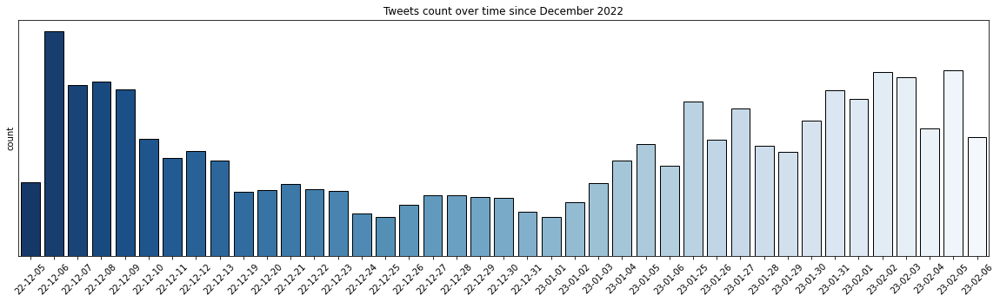

In [ ]:
plt.figure(figsize=(20,5))
ax = sns.barplot(x='index', y='counts', data=tweets_per_day,edgecolor = 'black',ci=False, palette='Blues_r')
plt.title('Tweets count over time since December 2022')
plt.yticks([])
plt.ylabel('count')
plt.xticks(rotation = 45)
plt.xlabel('')
plt.show()

Visualizing the attribute "source" in the dataset:

In [ ]:
# Source/ Value Count/Distribution of the Sources
df['source'].value_counts()

Twitter Web App        60283
Twitter for iPhone     26191
Twitter for Android    21065
TweetDeck               2078
Buffer                  1976
                       ...  
Streamlabs Twitter         1
Willow Social Media        1
NapoleonCat.com            1
AltBlackNews               1
OS X                       1
Name: source, Length: 487, dtype: int64

In [ ]:
# Plot the top value_counts
df['source'].value_counts().nlargest(10)

Twitter Web App        60283
Twitter for iPhone     26191
Twitter for Android    21065
TweetDeck               2078
Buffer                  1976
LinkedIn                1850
Twitter for iPad        1542
IFTTT                   1446
Hootsuite Inc.          1286
Twitter for Mac          730
Name: source, dtype: int64

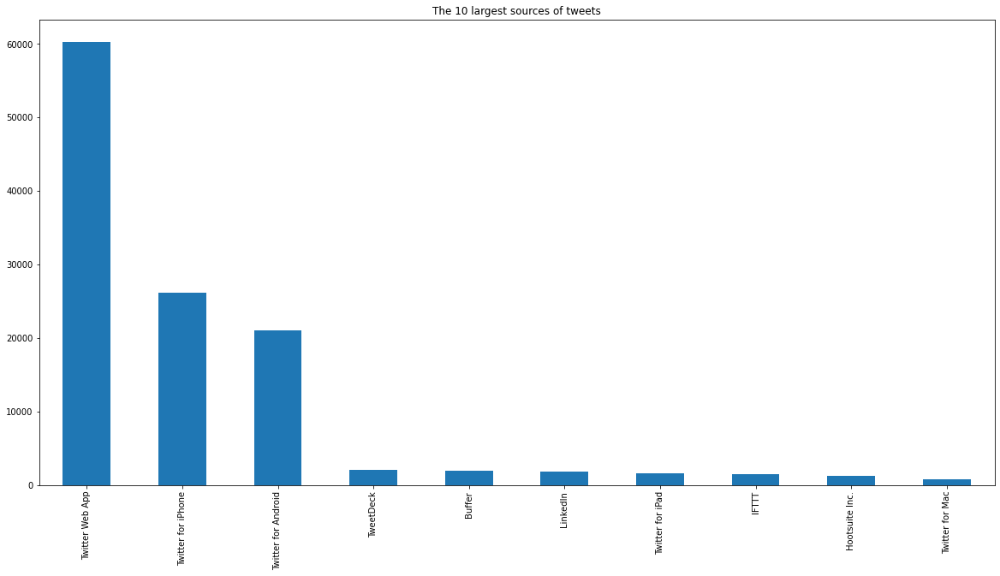

In [ ]:
# Plot the top value_counts
plt.figure(figsize=(20,10))
df['source'].value_counts().nlargest(10).plot(kind='bar')
plt.xticks(rotation=90)
plt.title('The 10 largest sources of tweets')
plt.show()

In [ ]:
print(f" Dataframe Shape: {df.shape}")

 Dataframe Shape: (127886, 10)


In [ ]:
df['user_followers'] = pd.to_numeric(df['user_followers'], errors='coerce')

In [ ]:
print(f" The user with the most followers is {df[df['user_followers'] == df['user_followers'].max()]['user_name'].iloc[0]}.")

 The user with the most followers is NDTV.


In [ ]:
df['user_friends'] = pd.to_numeric(df['user_friends'], errors='coerce')

In [ ]:
print(f" The user with the most friends is {df[df['user_friends'] == df['user_friends'].max()]['user_name'].iloc[0]}.")

 The user with the most friends is M LeMont.


Visualizing the attribute "user_verified" in the dataset:

In [ ]:
counts = df['user_verified'].value_counts()
print(counts)

False    123964
True       3922
Name: user_verified, dtype: int64


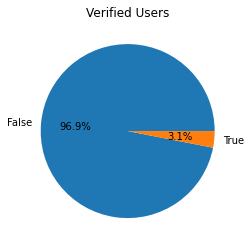

In [ ]:
counts.plot(kind='pie', autopct='%1.1f%%', labels=counts.index)
plt.title('Verified Users')
plt.ylabel("");

Now that the data is fundamentally cleaned, we want to take a look at the column 'text' in the dataframe:

In [ ]:
print(f"There are {str(df['text'].isnull().sum())} tweets with no content.")

There are 0 tweets with no content.


### Extracting the Emojis from the text field

In [ ]:
%pip install emoji

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 240.9/240.9 KB 18.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for emoji: filename=emoji-2.2.0-py3-none-any.whl size=234926 sha256=4e5892e5da69ed88089ae31efcb41131fe5322cc194fdc7b2babc6915fde8d19
  Stored in directory: /root/.cache/pip/wheels/86/62/9e/a6b27a681abcde69970dbc0326ff51955f3beac72f15696984
Successfully built emoji


In [ ]:
import pandas as pd
import emoji
import re
import regex


# Define a function to extract the emojis from a text column
def extract_emojis(text):
    emoji_pattern = re.compile("["
        u"\U0001F600-\U0001F64F"  # emoticons
        u"\U0001F300-\U0001F5FF"  # symbols & pictographs
        u"\U0001F680-\U0001F6FF"  # transport & map symbols
        u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           "]+", flags=re.UNICODE)
    return ''.join(emoji_pattern.findall(text))

In [ ]:
df['emojis'] = df['text'].apply(extract_emojis)

In [ ]:
df.isnull().sum()

user_name              0
text                   0
user_created           0
user_followers         0
user_friends           0
user_favourites        0
user_verified          0
date                   0
hashtags           24184
source                 0
emojis                 0
dtype: int64

In [ ]:
df.iloc[len(df)-1]

user_name                                            Norman Meuschke
text               #ChatGPT and similar #LLM pose a challenge to ...
user_created                               2011-02-22 18:03:52+00:00
user_followers                                                 149.0
user_friends                                                   262.0
user_favourites                                                  451
user_verified                                                  False
date                                       2022-12-05 17:08:20+00:00
hashtags                                          ['ChatGPT', 'LLM']
source                                               Twitter Web App
emojis                                                              
Name: 127919, dtype: object

### Data preparation for model training

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import re
import string

import nltk
from nltk.probability import FreqDist
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
nltk.download('stopwords')
nltk.download('punkt')
from nltk.stem import SnowballStemmer
from nltk import pos_tag
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize

from wordcloud import WordCloud
from tqdm.auto import tqdm
import matplotlib.style as style
style.use('fivethirtyeight')
from numpy import interp
from itertools import cycle
from sklearn.metrics import roc_curve, auc, plot_roc_curve

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
def remove_line_breaks(text):
    text = text.replace('\r', ' ').replace('\n', ' ')
    return text

#remove punctuation
def remove_punctuation(text):
    re_replacements = re.compile("__[A-Z]+__")  # such as __NAME__, __LINK__
    re_punctuation = re.compile("[%s]" % re.escape(string.punctuation))
    '''Escape all the characters in pattern except ASCII letters and numbers'''
    tokens = word_tokenize(text)
    tokens_zero_punctuation = []
    for token in tokens:
        if not re_replacements.match(token):
            token = re_punctuation.sub(" ", token)
        tokens_zero_punctuation.append(token)
    return ' '.join(tokens_zero_punctuation)

def remove_special_characters(text):
    text = re.sub('[^a-zA-z0-9\s]', '', text)
    return text

def lowercase(text):
    text_low = [token.lower() for token in word_tokenize(text)]
    return ' '.join(text_low)

def remove_stopwords(text):
    stop = set(stopwords.words('english'))
    word_tokens = nltk.word_tokenize(text)
    text = " ".join([word for word in word_tokens if word not in stop])
    return text

#remobe one character words
def remove_one_character_words(text):
    '''Remove words from dataset that contain only 1 character'''
    text_high_use = [token for token in word_tokenize(text) if len(token)>1]      
    return ' '.join(text_high_use)   
    
#%%
# Stemming with 'Snowball stemmer" package
def stem(text):
    stemmer = nltk.stem.snowball.SnowballStemmer('english')
    text_stemmed = [stemmer.stem(token) for token in word_tokenize(text)]        
    return ' '.join(text_stemmed)

def lemma(text):
    wordnet_lemmatizer = WordNetLemmatizer()
    word_tokens = nltk.word_tokenize(text)
    text_lemma = " ".join([wordnet_lemmatizer.lemmatize(word) for word in word_tokens])       
    return ' '.join(text_lemma)


#break sentences to individual word list
def sentence_word(text):
    word_tokens = nltk.word_tokenize(text)
    return word_tokens
#break paragraphs to sentence token 
def paragraph_sentence(text):
    sent_token = nltk.sent_tokenize(text)
    return sent_token    


def tokenize(text):
    """Return a list of words in a text."""
    return re.findall(r'\w+', text)

def remove_numbers(text):
    no_nums = re.sub(r'\d+', '', text)
    return ''.join(no_nums)

def give_emoji_free_text(text):
    """
    Removes emoji's from tweets
    Accepts:
        Text (tweets)
    Returns:
        Text (emoji free tweets)
    """
    emoji_list = [c for c in text if c in emoji.UNICODE_EMOJI]
    clean_text = ' '.join([str for str in text.split() if not any(i in str for i in emoji_list)])
    return clean_text

def url_free_text(text):
    '''
    Cleans text from urls
    '''
    text = re.sub(r'http\S+', '', text)
    return text


def clean_text(text):
    _steps = [
    remove_line_breaks,
    remove_one_character_words,
    remove_special_characters,
    lowercase,
    remove_punctuation,
    remove_stopwords,
    stem,
    remove_numbers,
    #give_emoji_free_text,
    url_free_text
]
    for step in _steps:
        text=step(text)
    return text   

In [ ]:
df2 = df.copy()

In [ ]:
df2.isnull().sum()

user_name              0
text                   0
user_created           0
user_followers         0
user_friends           0
user_favourites        0
user_verified          0
date                   0
hashtags           24184
source                 0
emojis                 0
dtype: int64

In [ ]:
df2.fillna('', inplace=True)

In [ ]:
df2.isnull().sum()

user_name          0
text               0
user_created       0
user_followers     0
user_friends       0
user_favourites    0
user_verified      0
date               0
hashtags           0
source             0
emojis             0
dtype: int64

In [ ]:
df2["text"] = df2["text"].astype(str)
df2["text"] = [x.replace(':',' ') for x in df2["text"]]

In [ ]:
df2['clean_text'] = pd.Series([clean_text(i) for i in tqdm(df2['text'])])

  0%|          | 0/127886 [00:00<?, ?it/s]

In [ ]:
df2["hashtags"] = df2["hashtags"].astype(str)
df2["hashtags"] = [x.replace(':',' ') for x in df2["hashtags"]]

In [ ]:
df2['clean_hashtags'] = pd.Series([clean_text(i) for i in tqdm(df2['hashtags'])])

  0%|          | 0/127886 [00:00<?, ?it/s]

In [ ]:
df_clean = df2[['clean_text', 'clean_hashtags']]

In [ ]:
df_clean.isnull().sum()

clean_text        34
clean_hashtags    34
dtype: int64

In [ ]:
np.where(pd.isnull(df_clean))

(array([127852, 127852, 127853, 127853, 127854, 127854, 127855, 127855,
        127856, 127856, 127857, 127857, 127858, 127858, 127859, 127859,
        127860, 127860, 127861, 127861, 127862, 127862, 127863, 127863,
        127864, 127864, 127865, 127865, 127866, 127866, 127867, 127867,
        127868, 127868, 127869, 127869, 127870, 127870, 127871, 127871,
        127872, 127872, 127873, 127873, 127874, 127874, 127875, 127875,
        127876, 127876, 127877, 127877, 127878, 127878, 127879, 127879,
        127880, 127880, 127881, 127881, 127882, 127882, 127883, 127883,
        127884, 127884, 127885, 127885]),
 array([0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1,
        0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1,
        0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1,
        0, 1]))

In [ ]:
df_clean.iloc[len(df_clean)-1]

clean_text        NaN
clean_hashtags    NaN
Name: 127919, dtype: object

In [ ]:
#df_clean_over_time = df2[['clean_text', 'clean_hashtags', 'date']]

In [ ]:
#df_clean_time_emoji = df2[['clean_text', 'clean_hashtags', 'date', 'emojis']]

In [ ]:
df_clean.to_csv('cleaned_tweets.csv', encoding='utf-8', index=False)

In [ ]:
#df_clean_over_time.to_csv('cleaned_tweets_over_time.csv', encoding='utf-8', index=False)

In [ ]:
#df_clean_time_emoji.to_csv('cleaned_tweets_time_emoji', encoding='utf-8', index=False)

In [ ]:
import gensim
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS
from nltk.stem import WordNetLemmatizer, SnowballStemmer
from nltk.stem.porter import *
import numpy as np
np.random.seed(2018)
import nltk
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
nltk.download('omw-1.4')

[nltk_data] Downloading package omw-1.4 to /root/nltk_data...


True

In [ ]:
stemmer = SnowballStemmer('english')

In [ ]:
def lemmatize_stemming(text):
    return stemmer.stem(WordNetLemmatizer().lemmatize(text, pos='v'))

def preprocess(text):
    result = []
    for token in gensim.utils.simple_preprocess(text):
        if token not in gensim.parsing.preprocessing.STOPWORDS and len(token) > 3:
            result.append(lemmatize_stemming(token))
    return result

Focus on 'text' column

In [ ]:
df_clean['clean_text'] = df_clean['clean_text'].astype(str)

<ipython-input-345-535b26912987>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_clean['clean_text'] = df_clean['clean_text'].astype(str)


In [ ]:
doc_sample = df_clean['clean_text'].iloc[1]
print('original document: ')

words = []

for word in doc_sample.split(' '):
    words.append(word)
    
    
print(words)
print('\n\n tokenized and lemmatized document: ')
print(preprocess(doc_sample))

original document: 
['chatgpt', 'anoth', 'woje', 'leftist', 'tool', 'noth', '', 'tcosvbxpma']


 tokenized and lemmatized document: 
['chatgpt', 'anoth', 'woje', 'leftist', 'tool', 'noth', 'tcosvbxpma']


In [ ]:
words = []

for i in df_clean['clean_text']:
        words.append(i.split(' '))

In [ ]:
dictionary = gensim.corpora.Dictionary(words)

count = 0
for k, v in dictionary.iteritems():
    print(k, v)
    count += 1
    if count > 10:
        break

0 abil
1 becom
2 chang
3 chatgpt
4 communic
5 construct
6 could
7 critic
8 forget
9 inform
10 possibl


Focus on 'text' column

In [ ]:
df_clean['clean_hashtags'] = df_clean['clean_hashtags'].astype(str)

<ipython-input-349-3346fd8d93d3>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_clean['clean_hashtags'] = df_clean['clean_hashtags'].astype(str)


In [ ]:
doc_sample = df_clean['clean_hashtags'].iloc[1]
print('original document: ')

words = []

for word in doc_sample.split(' '):
    words.append(word)
    
    
print(words)
print('\n\n tokenized and lemmatized document: ')
print(preprocess(doc_sample))

original document: 
['chatgpt', 'woje', 'leftist']


 tokenized and lemmatized document: 
['chatgpt', 'woje', 'leftist']


In [ ]:
words = []

for i in df_clean['clean_hashtags']:
        words.append(i.split(' '))

In [ ]:
dictionary = gensim.corpora.Dictionary(words)

count = 0
for k, v in dictionary.iteritems():
    print(k, v)
    count += 1
    if count > 10:
        break

0 chatgpt
1 leftist
2 woje
3 busi
4 fact
5 
6 ai
7 ceo
8 episod
9 futureofwork
10 podcast


### Worldcloud

In [ ]:
text = df_clean["clean_text"].values

In [ ]:
ls = []

for i in text:
    ls.append(str(i))

In [ ]:
ls_string = " ".join(map(str, ls))

print(ls_string)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
ls_new=list(ls_string.split())

In [ ]:
print(ls_new)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
mein_dict = dict.fromkeys(ls_new)
ls_clean = list(mein_dict)

In [ ]:
ls_clean[:5]

['chatgpt', 'realli', 'chang', 'shake', 'inform']

(-0.5, 1599.5, 799.5, -0.5)

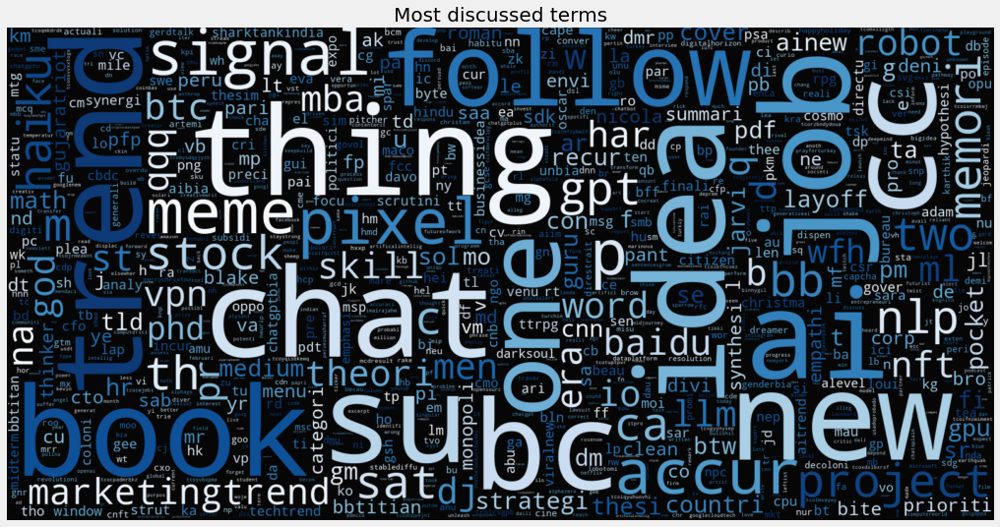

In [ ]:
# The wordcloud of text
plt.figure(figsize=(16,13))
wc = WordCloud(background_color="black", max_words=1000, max_font_size= 200,  width=1600, height=800)
wc.generate(" ".join(ls_clean))
plt.title("Most discussed terms", fontsize=20)
plt.imshow(wc.recolor( colormap= 'Blues_r' , random_state=17), alpha=0.98, interpolation="bilinear", )
plt.axis('off')

In [ ]:
hashtags = df_clean["clean_hashtags"].values

In [ ]:
ls = []

for i in hashtags:
    ls.append(str(i))

In [ ]:
ls_string = " ".join(map(str, ls))

print(ls_string)

chatgpt chatgpt woje leftist chatgpt busi chatgpt fact chatgpt chatgpt  podcast episod ai futureofwork ceo chatgpt   chatgpt playground chatgpt earthquak turkey prayforturkey staystrong whale usdt coinbas unknown generativeai chatgpt openai ai  computersci chatgpt ai chatbot   chatgpt chatsplain turkey turkiy deprem lufc chatgpt  chatgpt product chatgpt ai edtech insurtech financ chatgpt ai chatgpt chatgpt terrepl thorieducomplot  chatgpt cheat earthquak chatgpt stanbul tsunami chatgpt turkey chatgpt    meme ai ailaunchpad cryptolaunchpad chatgpt chatgpt artificialintellig aiproject  chatgpt chatgpt chatgpt chatgpt ai artificialintellig generativeai chatgpt chatgpt trumpwasrightabouteveryth biden hunterbiden hunterbidenslaptop gaslight chatgpt googl cybersecur podcast chatgpt chatgpt chatgpt   itexpert cyberattack chatgpt  chatgpt   chatgpt  chatgpt chatgpt galactica chatgpt chatgpt chatgpt chatgpt wealthtech  googl googledoodl chatgpt chathot  chat app world chatgpt chatgpt chatgpt  c

In [ ]:
ls_new=list(ls_string.split())

In [ ]:
print(ls_new)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
mein_dict = dict.fromkeys(ls_new)
ls_clean = list(mein_dict)

In [ ]:
ls_clean[:5]

['chatgpt', 'realli', 'chang', 'shake', 'inform']

(-0.5, 1599.5, 799.5, -0.5)

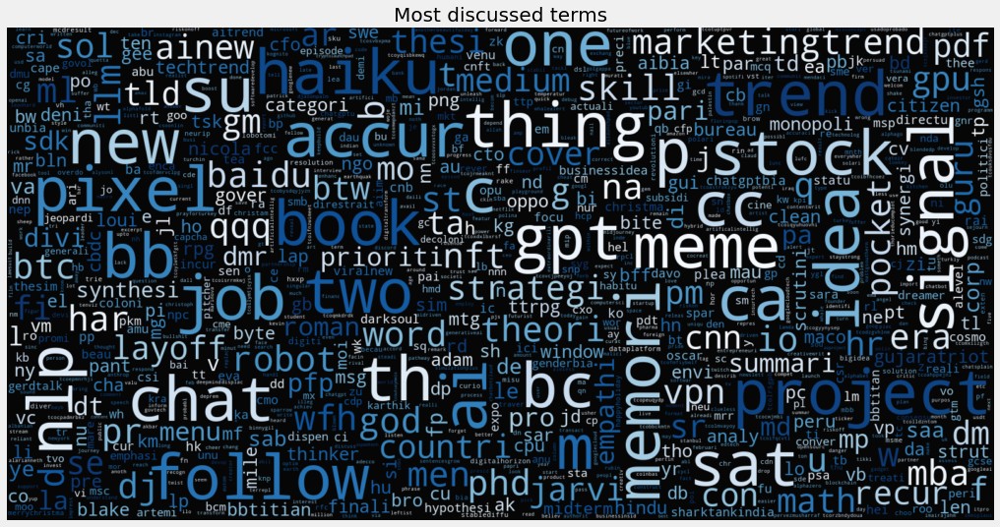

In [ ]:
# The wordcloud of Hashtags
plt.figure(figsize=(16,13))
wc = WordCloud(background_color="black", max_words=1000, max_font_size= 100,  width=1600, height=800)
wc.generate(" ".join(ls_clean))
plt.title("Most discussed terms", fontsize=20)
plt.imshow(wc.recolor( colormap= 'Blues_r' , random_state=17), alpha=0.98, interpolation="bilinear", )
plt.axis('off')

saving the cleaned data to a new csv file:

In [ ]:
df_clean.to_csv('cleaned_tweets.csv', encoding='utf-8', index=False)

# Topic Modelling

<b>ChatGPT:</b> \\
Topic modeling is a technique used in natural language processing (NLP) and machine learning to automatically extract the underlying themes or topics from a large corpus of text data. The goal of topic modeling is to discover the latent topics that are present in the text data, and to assign each document or piece of text to one or more of these topics.<br>
Topic modeling is a powerful tool for analyzing large volumes of text data, and it has a wide range of applications in many industries, including journalism, marketing, and finance. However, it is important to note that topic modeling is not a perfect method, and the results should always be reviewed and validated by a human expert.

### Imports

In [ ]:
%pip install bertopic
%pip install bertopic[flair]
%pip install bertopic[gensim]
%pip install bertopic[spacy]
%pip install bertopic[use]
%pip install plotly_express
%pip install bertopic[flair]
%pip install bertopic[gensim]
%pip install bertopic[spacy]
%pip install bertopic[use]
%pip install bertopic
%pip install plotly_express

In [ ]:
#Data manipulation and analysis:
import pandas as pd
import numpy as np
import csv

#Data visualization:
import seaborn as sns
import matplotlib.pyplot as plt
import plotly_express as px
import matplotlib.style as style

#Natural Language Processing:
import nltk
from nltk.probability import FreqDist
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
from nltk.stem import SnowballStemmer
from nltk import pos_tag
from nltk.tokenize import word_tokenize
nltk.download('stopwords')
nltk.download('punkt')
import re
import string
from sentence_transformers import SentenceTransformer

#Machine Learning:
#from sklearn.metrics import plot_roc_curve
from sklearn.metrics import roc_curve, auc
from sklearn.datasets import fetch_20newsgroups
from umap import UMAP

#Topic Modeling:
from bertopic import BERTopic

#Miscellaneous:
from tqdm.auto import tqdm
from itertools import cycle
from google.colab import drive

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


### General

In [ ]:
# # mount the 'My Drive' folder
drive.mount('/content/drive', force_remount=True)
df_time = pd.read_csv("/content/drive/MyDrive/NLP/cleaned_tweets_over_time.csv", engine='python', encoding="utf-8")
# df = pd.read_csv("cleaned_tweets.csv", engine='python', encoding="utf-8")
df = df_time[['clean_text']]
docs = df.clean_text.to_list()

Mounted at /content/drive


In [ ]:
model = BERTopic.load("/content/drive/MyDrive/NLP/modelling")

In [ ]:
model.get_topic_info().head(15) 

,Topic,Count,Name
0,-1,57116,-1_human_chatbot_ai_like
1,0,2814,0_oh_love_ok_damn
2,1,1967,1_teacher_student_classroom_teach
3,2,1306,2_tweet_twitter_retweet_thread
4,3,1165,3_market_sale_ecommerc_brand
5,4,1080,4_song_music_rap_lyric
6,5,1058,5_video_youtub_channel_script
7,6,1050,6_poem_poetri_poet_rhyme
8,7,961,7_game_changer_gamedev_play
9,8,793,8_technolog_societi_chang_innov


In [ ]:
model.visualize_topics()

In [ ]:
model.visualize_barchart()

In [ ]:
model.visualize_heatmap()

In [ ]:
model.visualize_term_rank()

allgemein ganzes Modell

Sinnvolen tOpics des Topic modellings für sentiment analysisi verwenden - > Bereichs sentiment analyses zu machen

redunctions + Fokus auf sinnvole interessante topics




### Auto Redunction

In [ ]:
topic_model = BERTopic.load("/content/drive/MyDrive/NLP/topic_modelling")

In [ ]:
topic_model.get_topic_info().head(16)

,Topic,Count,Name
0,-1,57116,-1_human_ai_chatbot_like
1,0,2814,0_love_oh_ok_damn
2,1,1967,1_teacher_student_teach_educ
3,2,1306,2_tweet_twitter_thread_retweet
4,3,1267,3_tcobretziyh_tcojrfundcqw_tcoiahynlmjnc_golden
5,4,1165,4_market_sale_ecommerc_brand
6,5,1080,5_song_music_rap_lyric
7,6,1058,6_video_youtub_channel_script
8,7,1050,7_poem_poetri_poet_rhyme
9,8,961,8_game_changer_play_gamedev


In [ ]:
topic = [0,1,2,4,5,6,7,10,13,14,15]

In [ ]:
topic_model.visualize_topics(topic)

In [ ]:
topic_model.visualize_barchart(topic)

In [ ]:
topic_model.visualize_heatmap(topic)

In [ ]:
topic_model.visualize_term_rank(topic)

### Redunction to 20

In [ ]:
topic_model_20 = BERTopic.load("/content/drive/MyDrive/NLP/modelling")

In [ ]:
topic_model_20.get_topic_info().head(16)

,Topic,Count,Name
0,-1,57116,-1_human_chatbot_ai_like
1,0,2814,0_oh_love_ok_damn
2,1,1967,1_teacher_student_classroom_teach
3,2,1306,2_tweet_twitter_retweet_thread
4,3,1165,3_market_sale_ecommerc_brand
5,4,1080,4_song_music_rap_lyric
6,5,1058,5_video_youtub_channel_script
7,6,1050,6_poem_poetri_poet_rhyme
8,7,961,7_game_changer_gamedev_play
9,8,793,8_technolog_societi_chang_innov


In [ ]:
topic = [0,1,2,5,13,14,15]

In [ ]:
topic_model_20.visualize_topics(topic)

In [ ]:
topic_model_20.visualize_barchart(topic)

In [ ]:
topic_model_20.visualize_heatmap(topic)

In [ ]:
topic_model_20.visualize_term_rank(topic)

### Redunction min

In [ ]:
topic_model_min = BERTopic.load("/content/drive/MyDrive/NLP/topic_modelling_min")

In [ ]:
topic_model_min.get_topic_info()

,Topic,Count,Name
0,-1,57116,-1_chatgpt_ai_openai_use
1,0,69656,0_chatgpt_ai_openai_use
2,1,351,1_excel_formula_matrix_chatgpt
3,2,312,2_limit_chatgpt_openai_use
4,3,202,3_entrepreneurship_entrepreneur_busi_economi
5,4,96,4_censorship_censor_chatgpt_openai
6,5,55,5_regex_help_chatgpt_write
7,6,33,6_vscode_code_extens_copilot
8,7,17,7_layoff_layoffs_googlelayoff_chatgpt
9,8,14,8_decomma_defi_thread_great


In [ ]:
topic_model_min.visualize_topics()

In [ ]:
topic_model_min.visualize_barchart()

In [ ]:
topic_model_min.visualize_heatmap()

In [ ]:
topic_model_min.visualize_term_rank()

### Time Series Analysis

In [ ]:
time_model = BERTopic.load("/content/drive/MyDrive/NLP/time_modelling")

In [ ]:
timestamps = df_time.date.to_list()
docs = df_time.clean_text.astype (str).to_list()

In [ ]:
time_model.get_topic_info().head(11)

,Topic,Count,Name
0,-1,57135,-1_ai_human_like_use
1,0,3266,0_love_ok_oh_cool
2,1,2104,1_openai_openaichatgpt_openaierc_openaichat
3,2,1170,2_tweet_twitter_retweet_thread
4,3,1096,3_song_music_rap_lyric
5,4,1076,4_poem_poetri_rhyme_poet
6,5,1058,5_video_youtub_channel_script
7,6,921,6_technolog_tech_advanc_innov
8,7,809,7_search_googl_engin_googlesearch
9,8,797,8_amp_electr_compressor_etsi


In [ ]:
tp = [0,1, 3,4,5,6,7]

In [ ]:
topics_over_time = time_model.topics_over_time(docs, timestamps,  global_tuning=True, evolution_tuning=True, nr_bins=20)

15it [01:50,  7.37s/it]


In [ ]:
time_model.visualize_topics_over_time(topics_over_time, topics=tp)

### Validierung Similarity

In [ ]:
#General
similar_topics, similarity = model.find_topics("education", top_n=5)
model.get_topic(similar_topics[0])

[('teacher', 0.01589213443134101),
 ('student', 0.012412315196405782),
 ('classroom', 0.011483041264744122),
 ('teach', 0.011139408562233376),
 ('educ', 0.010651030327806314),
 ('edtech', 0.008609333028446164),
 ('lesson', 0.007786899093573915),
 ('school', 0.00599976290990698),
 ('edchat', 0.004903726660973168),
 ('assign', 0.004748857135057071)]

In [ ]:
#General
similar_topics, similarity = model.find_topics("art", top_n=5)
model.get_topic(similar_topics[0])

[('artist', 0.04012362683435144),
 ('art', 0.030906255427480277),
 ('artwork', 0.013725360103258278),
 ('paint', 0.0079026977392731),
 ('dalle', 0.007897216798781479),
 ('aiart', 0.00711744686242771),
 ('creativ', 0.007014089447903036),
 ('jamesarthur', 0.006769388302153363),
 ('mosesclo', 0.006769388302153363),
 ('michelangelo', 0.006587115058282796)]

In [ ]:
#General
similar_topics, similarity = model.find_topics("technology", top_n=5)
model.get_topic(similar_topics[0])

[('technolog', 0.016972000819011065),
 ('societi', 0.003232849327581497),
 ('chang', 0.0031766797380104613),
 ('innov', 0.0031498869605575508),
 ('impact', 0.0029712283092985623),
 ('embrac', 0.0027349250605146246),
 ('breakthrough', 0.002684594759790575),
 ('advanc', 0.0026716057848698996),
 ('emerg', 0.002538193407039052),
 ('futur', 0.00251042568798805)]

In [ ]:
#General
similar_topics, similarity = model.find_topics("business", top_n=5)
model.get_topic(similar_topics[0])

[('market', 0.019529440114131956),
 ('sale', 0.011787051322846331),
 ('ecommerc', 0.010104721209221098),
 ('brand', 0.008561953928485898),
 ('digitalmarket', 0.008475724629057038),
 ('advertis', 0.007638894094387391),
 ('sell', 0.006948134638455619),
 ('salesforc', 0.006263599570323141),
 ('shopifi', 0.004657245300891926),
 ('affili', 0.0046198413906477845)]

In [ ]:
#General
similar_topics, similarity = model.find_topics("economy", top_n=5)
model.get_topic(similar_topics[0])

[('economi', 0.055422499953876804),
 ('economist', 0.048450470807367224),
 ('econom', 0.04151656710485622),
 ('ecosystem', 0.029226574663806803),
 ('econtwitt', 0.024225235403683612),
 ('ecolog', 0.014901981101944213),
 ('thembamyinkedworld', 0.013615212197988056),
 ('econ', 0.012371639574545994),
 ('contrast', 0.011518939340604217),
 ('instantan', 0.01083537627588418)]

In [ ]:
#General
similar_topics, similarity = model.find_topics("limitations", top_n=5)
model.get_topic(similar_topics[0])

[('limit', 0.07059764278118494),
 ('rate', 0.007689166512626491),
 ('push', 0.006907903124745296),
 ('exceed', 0.005099804840275987),
 ('threshold', 0.004967233497686098),
 ('length', 0.004642096174164724),
 ('iftf', 0.0044456565753221424),
 ('inx', 0.004246078688251141),
 ('limitless', 0.004093392243770679),
 ('maximum', 0.003937946748569162)]

In [ ]:
#General
similar_topics, similarity = model.find_topics("religion", top_n=5)
model.get_topic(similar_topics[0])

[('religion', 0.1370978773653958),
 ('atheism', 0.057944017984208354),
 ('belief', 0.039954249599057516),
 ('agnostic', 0.03420223490033933),
 ('christian', 0.03031858539363983),
 ('tcolmtdiwc', 0.024245014995449603),
 ('jainismrel', 0.024245014995449603),
 ('tcosrbpgbh', 0.024245014995449603),
 ('tcogbfcafxbr', 0.024245014995449603),
 ('orthodoxchristian', 0.024245014995449603)]

In [ ]:
#Auto Redunction
similar_topics, similarity = topic_model.find_topics("education", top_n=5)
topic_model.get_topic(similar_topics[0])

[('teacher', 0.018471704491349866),
 ('student', 0.014771744452829905),
 ('teach', 0.012901286509502683),
 ('educ', 0.01275834920339501),
 ('classroom', 0.012737930433725788),
 ('edtech', 0.009761348818872152),
 ('lesson', 0.008581616348140305),
 ('school', 0.00697443465425311),
 ('edchat', 0.005355066825471074),
 ('assign', 0.005339232096661523)]

In [ ]:
#Auto Redunction
similar_topics, similarity = topic_model.find_topics("art", top_n=5)
topic_model.get_topic(similar_topics[0])

[('artist', 0.04488782060092212),
 ('art', 0.03669466259315322),
 ('artwork', 0.01468934941078185),
 ('dalle', 0.009021067983708142),
 ('paint', 0.008577631620106314),
 ('aiart', 0.0083688084474278),
 ('creativ', 0.00822792038151194),
 ('mosesclo', 0.007041944587452409),
 ('jamesarthur', 0.007041944587452409),
 ('midjourney', 0.0069605148671244895)]

In [ ]:
#Auto Redunction
similar_topics, similarity = topic_model.find_topics("technology", top_n=5)
topic_model.get_topic(similar_topics[0])

[('technolog', 0.020710310264642928),
 ('chang', 0.003794419580759805),
 ('innov', 0.003715864240368172),
 ('societi', 0.0036011233248074),
 ('impact', 0.00344862721052646),
 ('advanc', 0.0030837083203620907),
 ('embrac', 0.0030450426199148894),
 ('futur', 0.0030443649276537706),
 ('breakthrough', 0.002927285401415604),
 ('emerg', 0.002800522375097524)]

In [ ]:
#Auto Redunction
similar_topics, similarity = topic_model.find_topics("business", top_n=5)
topic_model.get_topic(similar_topics[0])

[('market', 0.02338570130970648),
 ('sale', 0.013287710655819233),
 ('ecommerc', 0.010969289623362685),
 ('brand', 0.009616451264922105),
 ('digitalmarket', 0.009384731860607438),
 ('advertis', 0.00840835902330818),
 ('sell', 0.007696044608467486),
 ('salesforc', 0.006730830472742862),
 ('shopifi', 0.004952928641940741),
 ('affili', 0.004945384014586621)]

In [ ]:
#Auto Redunction
similar_topics, similarity = topic_model.find_topics("economy", top_n=5)
topic_model.get_topic(similar_topics[0])

[('economi', 0.0605384322686123),
 ('economist', 0.05114717953008438),
 ('econom', 0.04538182850808187),
 ('ecosystem', 0.031492933308675246),
 ('econtwitt', 0.02557358976504219),
 ('ecolog', 0.015582493700009038),
 ('thembamyinkedworld', 0.014127624245623735),
 ('econ', 0.012883289379165414),
 ('contrast', 0.012190812180333773),
 ('instantan', 0.011345256340331103)]

In [ ]:
#Auto Redunction
similar_topics, similarity = topic_model.find_topics("limitations", top_n=5)
topic_model.get_topic(similar_topics[0])

[('limit', 0.08137265726785829),
 ('rate', 0.008479745880515355),
 ('push', 0.007609117523340961),
 ('exceed', 0.005412727974694664),
 ('threshold', 0.005230821916659063),
 ('length', 0.004952155594604519),
 ('iftf', 0.004605538246268834),
 ('inx', 0.0044058809626064755),
 ('limitless', 0.0043532771793203745),
 ('charact', 0.004320988776818782)]

In [ ]:
#Auto Redunction
similar_topics, similarity = topic_model.find_topics("religion", top_n=5)
topic_model.get_topic(similar_topics[0])

[('religion', 0.12090420892464912),
 ('hindu', 0.04646472087224785),
 ('hinduphobia', 0.042749452204998865),
 ('christian', 0.04212283589857108),
 ('hinduism', 0.03861338933917759),
 ('god', 0.0313678796934498),
 ('hindus', 0.027481790703213556),
 ('removechatgptbia', 0.027101197951615145),
 ('dumber', 0.02335666260626092),
 ('youtubepeepoy', 0.021358171466202388)]

In [ ]:
#Redunction 20
similar_topics, similarity = topic_model_20.find_topics("education", top_n=5)
topic_model_20.get_topic(similar_topics[0])

[('teacher', 0.01589213443134101),
 ('student', 0.012412315196405782),
 ('classroom', 0.011483041264744122),
 ('teach', 0.011139408562233376),
 ('educ', 0.010651030327806314),
 ('edtech', 0.008609333028446164),
 ('lesson', 0.007786899093573915),
 ('school', 0.00599976290990698),
 ('edchat', 0.004903726660973168),
 ('assign', 0.004748857135057071)]

In [ ]:
#Redunction 20
similar_topics, similarity = topic_model_20.find_topics("art", top_n=5)
topic_model_20.get_topic(similar_topics[0])

[('artist', 0.04012362683435144),
 ('art', 0.030906255427480277),
 ('artwork', 0.013725360103258278),
 ('paint', 0.0079026977392731),
 ('dalle', 0.007897216798781479),
 ('aiart', 0.00711744686242771),
 ('creativ', 0.007014089447903036),
 ('jamesarthur', 0.006769388302153363),
 ('mosesclo', 0.006769388302153363),
 ('michelangelo', 0.006587115058282796)]

In [ ]:
#Redunction 20
similar_topics, similarity = topic_model_20.find_topics("technology", top_n=5)
topic_model_20.get_topic(similar_topics[0])

[('technolog', 0.016972000819011065),
 ('societi', 0.003232849327581497),
 ('chang', 0.0031766797380104613),
 ('innov', 0.0031498869605575508),
 ('impact', 0.0029712283092985623),
 ('embrac', 0.0027349250605146246),
 ('breakthrough', 0.002684594759790575),
 ('advanc', 0.0026716057848698996),
 ('emerg', 0.002538193407039052),
 ('futur', 0.00251042568798805)]

In [ ]:
#Redunction 20
similar_topics, similarity = topic_model_20.find_topics("business", top_n=5)
topic_model_20.get_topic(similar_topics[0])

[('market', 0.019529440114131956),
 ('sale', 0.011787051322846331),
 ('ecommerc', 0.010104721209221098),
 ('brand', 0.008561953928485898),
 ('digitalmarket', 0.008475724629057038),
 ('advertis', 0.007638894094387391),
 ('sell', 0.006948134638455619),
 ('salesforc', 0.006263599570323141),
 ('shopifi', 0.004657245300891926),
 ('affili', 0.0046198413906477845)]

In [ ]:
#Redunction 20
similar_topics, similarity = topic_model_20.find_topics("economy", top_n=5)
topic_model_20.get_topic(similar_topics[0])

[('economi', 0.055422499953876804),
 ('economist', 0.048450470807367224),
 ('econom', 0.04151656710485622),
 ('ecosystem', 0.029226574663806803),
 ('econtwitt', 0.024225235403683612),
 ('ecolog', 0.014901981101944213),
 ('thembamyinkedworld', 0.013615212197988056),
 ('econ', 0.012371639574545994),
 ('contrast', 0.011518939340604217),
 ('instantan', 0.01083537627588418)]

In [ ]:
#Redunction 20
similar_topics, similarity = topic_model_20.find_topics("limitations", top_n=5)
topic_model_20.get_topic(similar_topics[0])

[('limit', 0.07059764278118494),
 ('rate', 0.007689166512626491),
 ('push', 0.006907903124745296),
 ('exceed', 0.005099804840275987),
 ('threshold', 0.004967233497686098),
 ('length', 0.004642096174164724),
 ('iftf', 0.0044456565753221424),
 ('inx', 0.004246078688251141),
 ('limitless', 0.004093392243770679),
 ('maximum', 0.003937946748569162)]

In [ ]:
#Redunction 20
similar_topics, similarity = topic_model_20.find_topics("religion", top_n=5)
topic_model_20.get_topic(similar_topics[0])

[('religion', 0.1370978773653958),
 ('atheism', 0.057944017984208354),
 ('belief', 0.039954249599057516),
 ('agnostic', 0.03420223490033933),
 ('christian', 0.03031858539363983),
 ('tcolmtdiwc', 0.024245014995449603),
 ('jainismrel', 0.024245014995449603),
 ('tcosrbpgbh', 0.024245014995449603),
 ('tcogbfcafxbr', 0.024245014995449603),
 ('orthodoxchristian', 0.024245014995449603)]

In [ ]:
#Redunction min
similar_topics, similarity = topic_model_min.find_topics("education", top_n=5)
topic_model_min.get_topic(similar_topics[0])

[('entrepreneurship', 0.1204670691554129),
 ('entrepreneur', 0.09926278097016171),
 ('busi', 0.08142226697644264),
 ('economi', 0.06658558846508085),
 ('startup', 0.06243161890177887),
 ('chatgpt', 0.05623768215663753),
 ('econom', 0.05070770223422765),
 ('success', 0.04435161608165566),
 ('ai', 0.043864102927369114),
 ('economist', 0.04008155977527191)]

In [ ]:
#Redunction min
similar_topics, similarity = topic_model_min.find_topics("art", top_n=5)
topic_model_min.get_topic(similar_topics[0])

[('chatgpt', 0.06256560415653112),
 ('ai', 0.04539380140608653),
 ('openai', 0.02899203569158117),
 ('use', 0.024834376358003063),
 ('like', 0.017405913899694096),
 ('ask', 0.016770701770186983),
 ('write', 0.016060327409893053),
 ('nt', 0.015026313031748551),
 ('googl', 0.014401802588494784),
 ('gpt', 0.014144234260475232)]

In [ ]:
#Redunction min
similar_topics, similarity = topic_model_min.find_topics("technology", top_n=5)
topic_model_min.get_topic(similar_topics[0])

[('chatgpt', 0.06256560415653112),
 ('ai', 0.04539380140608653),
 ('openai', 0.02899203569158117),
 ('use', 0.024834376358003063),
 ('like', 0.017405913899694096),
 ('ask', 0.016770701770186983),
 ('write', 0.016060327409893053),
 ('nt', 0.015026313031748551),
 ('googl', 0.014401802588494784),
 ('gpt', 0.014144234260475232)]

In [ ]:
#Redunction min
similar_topics, similarity = topic_model_min.find_topics("business", top_n=5)
topic_model_min.get_topic(similar_topics[0])

[('entrepreneurship', 0.1204670691554129),
 ('entrepreneur', 0.09926278097016171),
 ('busi', 0.08142226697644264),
 ('economi', 0.06658558846508085),
 ('startup', 0.06243161890177887),
 ('chatgpt', 0.05623768215663753),
 ('econom', 0.05070770223422765),
 ('success', 0.04435161608165566),
 ('ai', 0.043864102927369114),
 ('economist', 0.04008155977527191)]

In [ ]:
#Redunction min
similar_topics, similarity = topic_model_min.find_topics("economy", top_n=5)
topic_model_min.get_topic(similar_topics[0])

[('entrepreneurship', 0.1204670691554129),
 ('entrepreneur', 0.09926278097016171),
 ('busi', 0.08142226697644264),
 ('economi', 0.06658558846508085),
 ('startup', 0.06243161890177887),
 ('chatgpt', 0.05623768215663753),
 ('econom', 0.05070770223422765),
 ('success', 0.04435161608165566),
 ('ai', 0.043864102927369114),
 ('economist', 0.04008155977527191)]

In [ ]:
#Redunction min
similar_topics, similarity = topic_model_min.find_topics("limitations", top_n=5)
topic_model_min.get_topic(similar_topics[0])

[('limit', 0.37272355892731557),
 ('chatgpt', 0.07389886502570663),
 ('openai', 0.031244633342765844),
 ('use', 0.027294632789052517),
 ('rate', 0.025531164933316156),
 ('push', 0.02267062093187032),
 ('nt', 0.022280627407591014),
 ('know', 0.0209630133294761),
 ('ask', 0.020767253703185808),
 ('ai', 0.019699548850992538)]

In [ ]:
#Redunction min
similar_topics, similarity = topic_model_min.find_topics("religion", top_n=5)
topic_model_min.get_topic(similar_topics[0])

[('censorship', 0.3638231161856446),
 ('censor', 0.12325153199837377),
 ('chatgpt', 0.055651499126287564),
 ('openai', 0.04655560523652227),
 ('semenov', 0.03066123185444021),
 ('elonmusk', 0.029417751838521036),
 ('twitter', 0.029390570782536825),
 ('restrict', 0.02786329559196503),
 ('ai', 0.02762256865515747),
 ('roman', 0.026300414569440315)]

### Results

Final Topics for Sentiment Analysis:

0: Education<br>
1: Art<br>
2: Technology<br>
3: Business<br>



Final Emotions for Sentiment Analysis:

0: Excited<br>
1: Curious<br>
2: Critical<br>
3: Afraid<br>
4: Rejecting<br>

# Sentiment Analysis

Sentiment analysis is a technique used in NLP and ML to automatically analyze and classify the sentiment or emotion expressed in a piece of text. The goal of sentiment analysis is to determine whether a piece of text expresses a positive, negative, or neutral sentiment, and to what degree.


###Imports

In [6]:
# basic data analysis
import csv
import pandas as pd
import numpy as np

# visualization
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import plotly_express as px
import plotly.graph_objects as go
from matplotlib import cm
from math import log10

# basic sentiment analysis
import nltk
from textblob import TextBlob
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# emotion analysis
from nrclex import NRCLex


# zero shot classification
import torch
from transformers import pipeline, AutoTokenizer, AutoModelForSequenceClassification
from scipy.special import softmax

## General

In [7]:
# defining a basic color list for the plots
colors = ['#0474a4', '#04ac84', '#efbb08']

In [10]:
sentiment_df = pd.read_csv('/content/drive/MyDrive/NLP/roberta_vader.csv')
sentiment_df = sentiment_df.reset_index().set_index('id')
sentiment_df = sentiment_df.iloc[:, 3:]

In [11]:
# converting the needed numeric columns and date
sentiment_df[['subjectivity', 'polarity', 'sentiment_vader', 'sentiment_roberta', 'vader_polarity']] = sentiment_df[['subjectivity', 'polarity', 'sentiment_vader', 'sentiment_roberta', 'vader_polarity']].apply(pd.to_numeric)
sentiment_df['date'] = pd.to_datetime(sentiment_df['date']).dt.date

## Subjectivity and Polarity Analysis

In [12]:
# calculating subjectivity and polarity per day
sub_grouped = sentiment_df.groupby('date').agg({'subjectivity': 'mean'}) 
pol_grouped = sentiment_df.groupby('date').agg({'polarity': 'mean'}) 

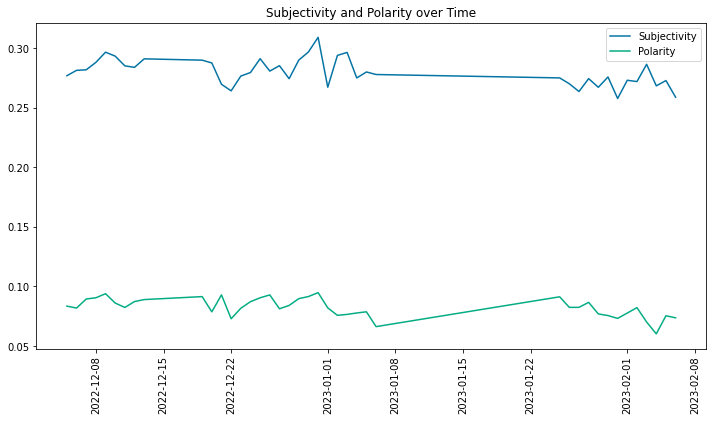

In [13]:
fig, ax = plt.subplots(figsize=(12, 6))
plt.plot(sub_grouped.index, sub_grouped['subjectivity'], label='Subjectivity', color=colors[0])
plt.plot(pol_grouped.index, pol_grouped['polarity'], label='Polarity', color=colors[1])
plt.xticks(rotation=90)
plt.title('Subjectivity and Polarity over Time')
plt.legend()
plt.show()

**Result:**<br>


### Polarity Comparison

In [14]:
polarity_df = sentiment_df[['polarity', 'vader_polarity']]
polarity_df = polarity_df.rename(columns={'polarity': 'TextBlob',
                                          'vader_polarity': 'Vader'})
fig = px.histogram(polarity_df, x=['Vader', 'TextBlob'], nbins=40, barmode='group',
                   color_discrete_sequence=colors)
fig.update_layout(title='Comparison of the distributions of sentimental polarities',
                  xaxis_title='Polarity', yaxis_title='Count')
fig.show()

**Result:**<br>
This graph allows us to see that although Vader and TextBlob use a similar method, the results are not exactly the same.<br> There is a slight shift on the positive side of the polarity.

### Emojis

In [15]:
emojis = pd.read_csv('/content/drive/MyDrive/NLP/emojis.csv', index_col=None)

In [16]:
emojis = emojis.iloc[:, 1:]

In [17]:
# extracting the 10 most used emojis
top_10_emojis = emojis.value_counts().nlargest(10)
emoji_df = pd.DataFrame(top_10_emojis)
emoji_df = emoji_df.reset_index()
#visualizing them
fig = px.bar(emoji_df, x='emojis', y=emoji_df[0], text=emoji_df[0], color_discrete_sequence=colors)

fig.update_layout(title='The 10 most used emojis in the tweets')
fig.update_xaxes(title='')
fig.update_yaxes(title='')
fig.update_yaxes(tickvals=[])

fig.show()

**Result:**<br>
There is an overwhelming majority of laughing and hand pointing downward emojis. In total there is little to learn from these results except maybe for the fire and the rocket emoji in 3rd and 5th place which might be associated with the innovation of the new technology.



## Sentiment Analysis of the Tweets

### Using NLTK Vader

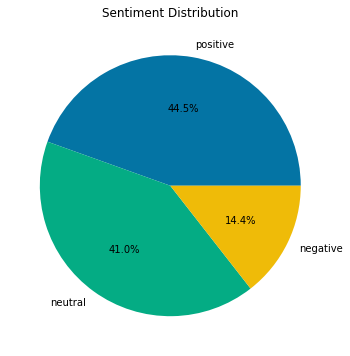

In [18]:
counts = sentiment_df['sentiment'].value_counts()
fig, ax = plt.subplots(figsize=(6, 6))
counts.plot(kind='pie', autopct='%1.1f%%', labels=counts.index, colors=colors)
plt.title('Sentiment Distribution')
plt.ylabel("");

**Result:**<br>
According to Vader, there are about as many positive as neutral tweets in the dataset and rather fewer negative tweets. That could mean, that Twitter Users in general are not negative towards ChatGPT.

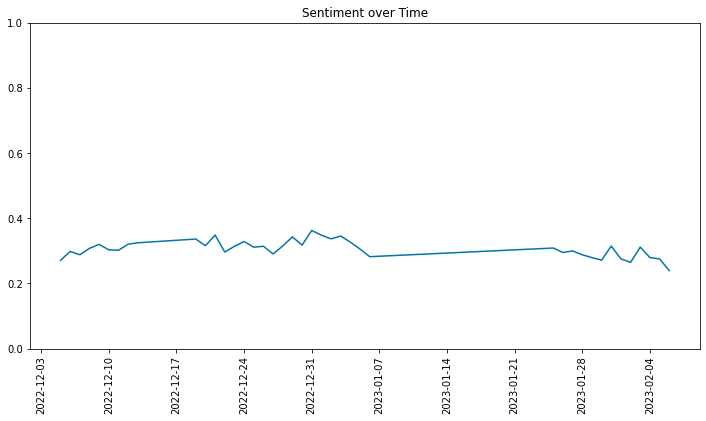

In [19]:
sentiment_grouped = sentiment_df.groupby('date').agg({'sentiment_vader': 'mean'}) 
fig, ax = plt.subplots(figsize=(12, 6))

plt.plot(sentiment_grouped.index, sentiment_grouped['sentiment_vader'], color=colors[0])
plt.xticks(rotation=90) 
plt.title('Sentiment over Time')
ax.xaxis.set_major_locator(mdates.DayLocator(interval=7))
ax.set_ylim([0, 1])
plt.show()

**Result:**<br>
When calculating the mean sentiment over time, you can see that it is always between neutral (0) and positive (1) and that it varies betweet 0.2 and 0.4.

### Comparison to Roberta Model

Using the "cardiffnlp/twitter-roberta-base-sentiment" model from Hugging Face

In [20]:
comparison_df = sentiment_df[['roberta_sentiment', 'vader_sentiment', 'date']]

In [21]:
comparison_df = comparison_df.rename(columns={'roberta_sentiment': 'Roberta',
                                          'vader_sentiment': 'Vader'})

fig = px.histogram(comparison_df, x=[comparison_df['Vader'], comparison_df['Roberta']], nbins=3, barmode='group',
                   color_discrete_sequence=colors)
fig.update_layout(title='Comparison of Roberta and Vader regarding the sentiment distribution',
                  xaxis_title='Sentiment Class', yaxis_title='Count')
fig.show()

In [22]:
roberta = comparison_df['Roberta'].value_counts()
vader = comparison_df['Vader'].value_counts()

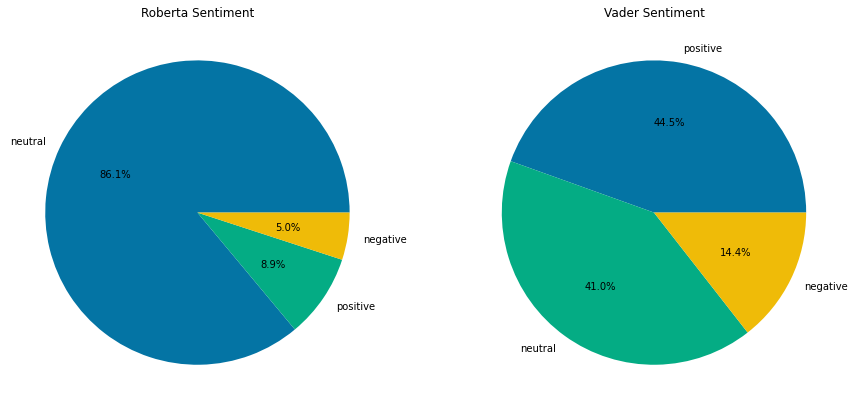

In [23]:
fig, ax = plt.subplots(1, 2, figsize=(15, 8))
roberta.plot.pie(autopct='%1.1f%%', labels=roberta.index, colors=colors, ax=ax[0])
vader.plot.pie(autopct='%1.1f%%', labels=vader.index, colors=colors, ax=ax[1])
ax[0].set_title('Roberta Sentiment')
ax[1].set_title('Vader Sentiment')
ax[0].set_ylabel('')
ax[1].set_ylabel('')
plt.show()

In [24]:
vader_grouped = sentiment_df.groupby('date').agg({'sentiment_vader': 'mean'}) 
roberta_grouped = sentiment_df.groupby('date').agg({'sentiment_roberta': 'mean'})

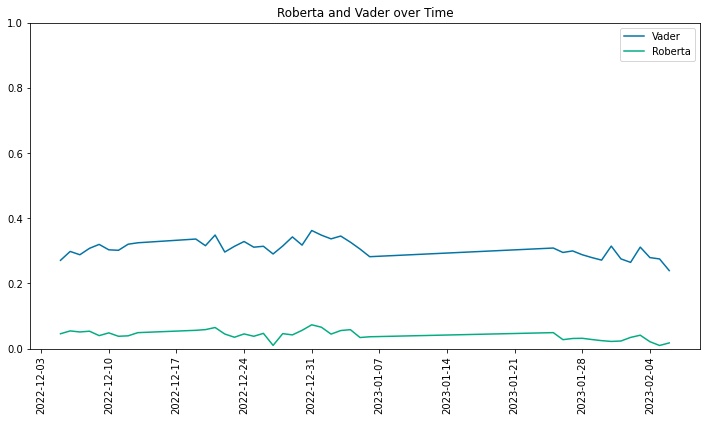

In [25]:
fig, ax = plt.subplots(figsize=(12, 6))

plt.plot(sub_grouped.index, vader_grouped, label='Vader', color=colors[0])
plt.plot(pol_grouped.index, roberta_grouped, label='Roberta', color=colors[1])
plt.xticks(rotation=90)
plt.title('Roberta and Vader over Time')
plt.legend()
ax.xaxis.set_major_locator(mdates.DayLocator(interval=7))
ax.set_ylim([0, 1])
plt.show()

**Result:**<br>
Looking at the comparison results, you can see that there are differences in the sentiment classification between Roberta and Vader. While Roberta recognises a lot of neutral tweets and rather few positive and negative ones, Vader's result is rather balanced across the three sentiment classes. <br>
Considering that this Roberta model has been trained on ~58M tweets and finetuned for sentiment analysis with the TweetEval benchmarkt, its prediction may be more accurate in this context (cf. https://huggingface.co/cardiffnlp/twitter-roberta-base-sentiment). Vader, on the other hand, is a rule-based sentiment analysis tool that uses a lexicon of words and their associated sentiment scores to determine the overall sentiment of a text. That means it was not specifically trained for tweets.

## Emotion Analysis

In [26]:
sentiment_df['Emotion'].value_counts()

positive        39496
No emotion      32916
trust           24075
fear            10466
negative         7372
anticipation     7039
anger            3489
surprise         2653
sadness           192
joy                90
disgust            64
Name: Emotion, dtype: int64

=> 

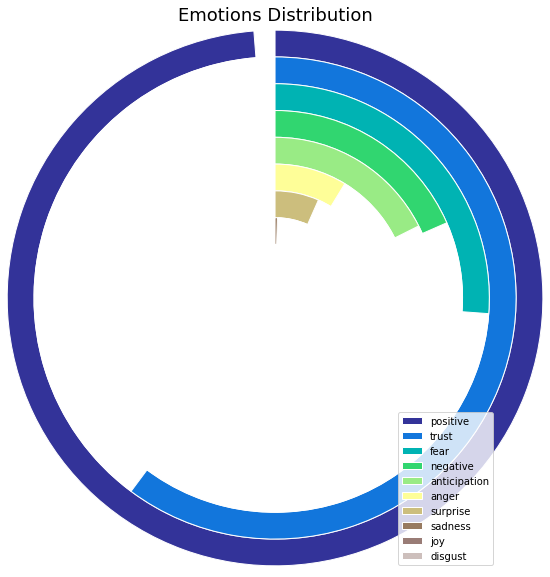

In [27]:
df_chart = sentiment_df[sentiment_df.Emotion != "No emotion"]
labels = df_chart.Emotion.value_counts().index.tolist()
data = df_chart.Emotion.value_counts()
#number of data points
n = len(data)
#find max value for full ring
k = 10 ** int(log10(max(data)))
m = k * (1 + max(data) // k)

#radius of donut chart
r = 1.5
#calculate width of each ring
w = r / n 

#create colors along a chosen colormap
colors = [cm.terrain(i / n) for i in range(n)]

plt.rcParams['figure.figsize'] = [8, 10]

#create figure, axis
fig, ax = plt.subplots()
ax.axis("equal")

#create rings of donut chart
for i in range(n):
    #hide labels in segments with textprops: alpha = 0 - transparent, alpha = 1 - visible
    innerring, _ = ax.pie([m - data[i], data[i]], radius = r - i * w, startangle = 90, labels = ["", labels[i]], labeldistance = 1 - 1 / (1.5 * (n - i)), textprops = {"alpha": 0}, colors = ["white", colors[i]])
    plt.setp(innerring, width = w, edgecolor = "white")

ax.set_title('Emotions Distribution', fontsize=18)
plt.legend(loc='lower right')
plt.show()

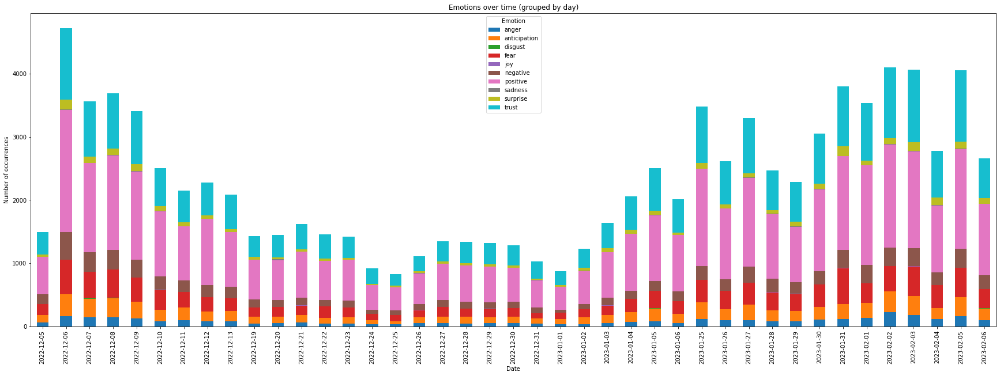

In [34]:
# Filter out 'No emotion' values
df_chart = sentiment_df[sentiment_df['Emotion'] != 'No emotion']

# Group by day and count number of occurrences for each emotion
df_grouped = df_chart.groupby([df_chart['date'], 'Emotion']).size().unstack().fillna(0)

# Plot the stacked bar chart
ax = df_grouped.plot(kind='bar', stacked=True, figsize=(30,10))

# Set the title and labels
ax.set_title("Emotions over time (grouped by day)")
ax.set_xlabel("Date")
ax.set_ylabel("Number of occurrences")

# Show the plot
plt.show()

In [29]:
# Group by day and count number of occurrences for each emotion
df_grouped = df_chart.groupby([df_chart['date'].dt.date, 'Emotion']).size().unstack().fillna(0)

fig = go.Figure()
for col in df_grouped.columns:
    fig.add_trace(go.Scatter(x=df_grouped.index, y=df_grouped[col], mode='lines', name=col))

# Set the title and labels
fig.update_layout(title="Emotions over time (grouped by day)", xaxis_title="", yaxis_title="Number of occurrences", xaxis_tickangle=-90)
fig.update_xaxes(tickvals=df_grouped.index[::2])

# Show the plot
fig.show()

**Result:**<br>
Looking at the two charts above, it's visible that the positive sentiments outweigh the negatives. The two most present sentiments in the tweets are 'positive' and 'trust' which might be a good sign for Chat GPT regarding these tweets. The third most common sentiment is fear, which indicates that there are not only positive feelings towards Chat GPT. Two sentiments which almost don't occur at all are disgust and sadness, which also speaks for the fact that in general there are not many very negative feelings in the tweets.

# Conclusion

### Using Zero-Shot Classification with Facebook bart-large-mnli

In [96]:
positives = pd.read_csv('/content/drive/MyDrive/NLP/positives.csv')
positives = positives.iloc[:, 1:]

In [99]:
negatives = pd.read_csv('/content/drive/MyDrive/NLP/negatives.csv')
negatives = negatives.iloc[:, 1:]

In [101]:
# group the dataframe by topic and sentiment, and count the number of occurrences
grouped_df = positives.groupby(['topic', 'sentiment']).size().reset_index(name='count')

# create a grouped bar chart
fig = px.bar(grouped_df, x='topic', y='count', color='sentiment', barmode='group', color_discrete_sequence=colors)

# set the chart title and axis labels
fig.update_layout(title='Positive Sentiment Distribution by Topic', xaxis_title='Topic', yaxis_title='Count')

# show the chart
fig.show()

In [102]:
# group the dataframe by topic and sentiment, and count the number of occurrences
grouped_df = negatives.groupby(['topic', 'sentiment']).size().reset_index(name='count')

# create a grouped bar chart
fig = px.bar(grouped_df, x='topic', y='count', color='sentiment', barmode='group', color_discrete_sequence=colors)

# set the chart title and axis labels
fig.update_layout(title='Negative Sentiment Distribution by Topic', xaxis_title='Topic', yaxis_title='Count')

# show the chart
fig.show()

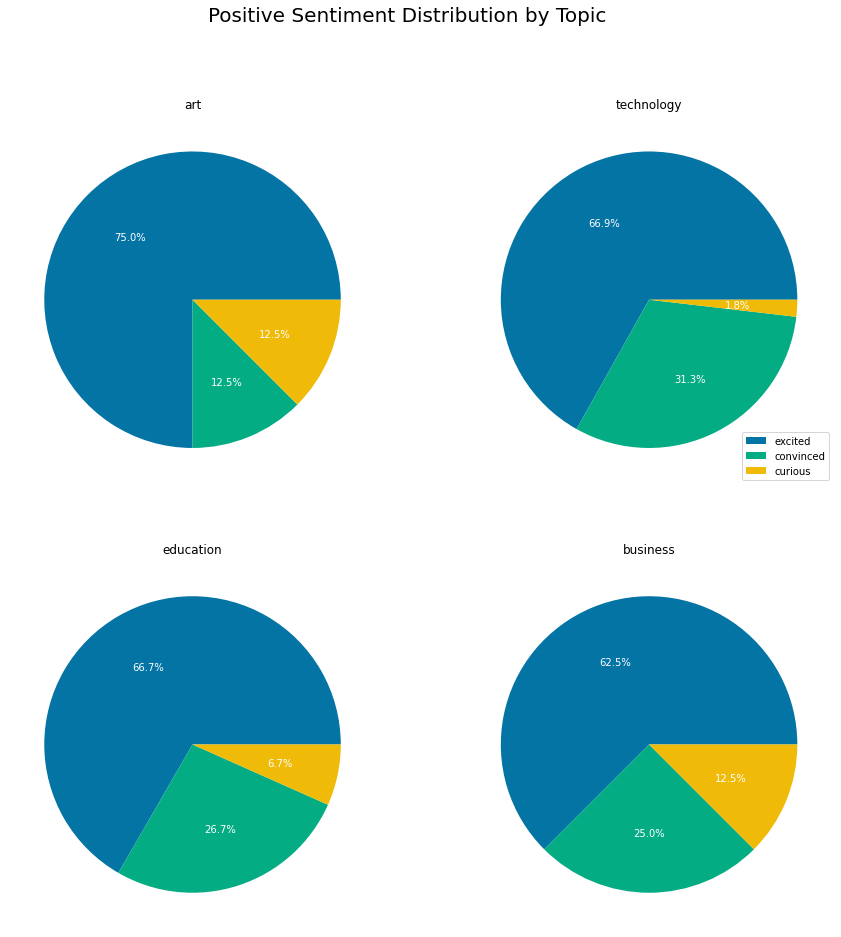

In [103]:
# divide the dataframe by topic
topics = positives['topic'].unique()
topic_dfs = [positives[positives['topic']==t] for t in topics]

# create a 2x2 subplot with pie charts
fig, axs = plt.subplots(2, 2, figsize=(15, 15))

# plot the sentiment distribution for each topic in a pie chart only using the columns 'sentiment'
for i, ax in enumerate(axs.flatten()):
    ax.pie(topic_dfs[i]['sentiment'].value_counts(), autopct='%1.1f%%', textprops={'color':"w"}, colors=colors)
    ax.set_title(topics[i])
axs[0, 1].legend(topic_dfs[1]['sentiment'].unique(), loc='lower right')

# add a common title to the chart
fig.suptitle('Positive Sentiment Distribution by Topic', fontsize=20)

plt.show() 

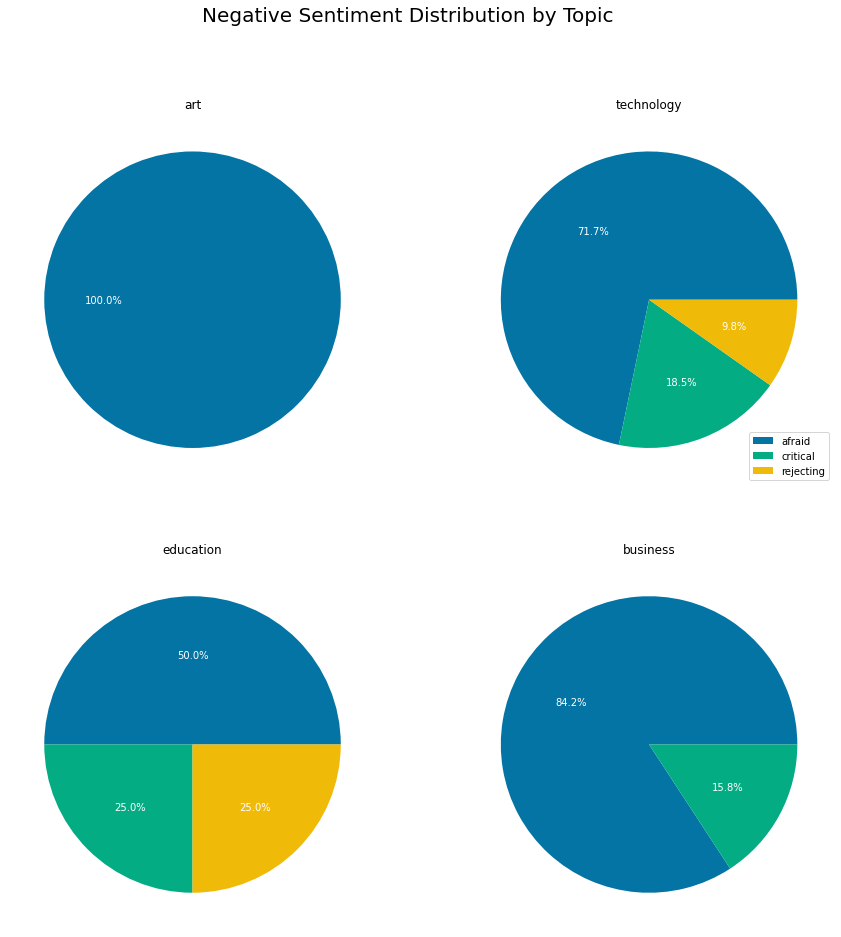

In [104]:
# divide the dataframe by topic
topics = negatives['topic'].unique()
topic_dfs = [negatives[negatives['topic']==t] for t in topics]

# create a 2x2 subplot with pie charts
fig, axs = plt.subplots(2, 2, figsize=(15, 15))

# plot the sentiment distribution for each topic in a pie chart only using the columns 'sentiment'
for i, ax in enumerate(axs.flatten()):
    ax.pie(topic_dfs[i]['sentiment'].value_counts(), autopct='%1.1f%%', textprops={'color':"w"}, colors=colors)
    ax.set_title(topics[i])
axs[0, 1].legend(topic_dfs[1]['sentiment'].unique(), loc='lower right')

# add a common title to the chart
fig.suptitle('Negative Sentiment Distribution by Topic', fontsize=20)

plt.show() 

**Result:**<br>
Looking at the distribution of the sentiment in each topic, you can see 

### What is the future of Chat GPT in society?



0: Education<br>
dominierende Emotion: 


1: Art<br>
dominierende Emotion: 


2: Technology<br>
dominierende Emotion: 


3: Business<br>
dominierende Emotion: 





Final Emotions for Sentiment Analysis:

0: Excited<br>
1: Curious<br>
2: Convinced<br>

2: Critical<br>
3: Afraid<br>
4: Rejecting<br>